#<center>You are the Monet youself</center>
###<center>Group B</center>
###<center>Peifeng Li, Yuxin Song, Lin Zheng</center>

#Introduction

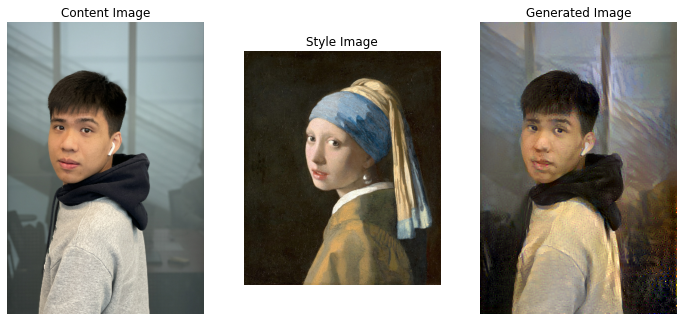

We recognize the works of artists through their unique style, such as color choices or brush strokes. The artists like Claude Monet can now be imitated with algorithms thanks to generative adversarial networks (GANs). In this project, we will bring that Monet style to photos or recreate the style of monet!

## The Challenge
we have 300 Monet style image and 7028 photos in our dataset and they are all in 256x256 format. We may need to extract the style patten from Monet image and convert the style onto the photo we have. 


### Monet Style Image

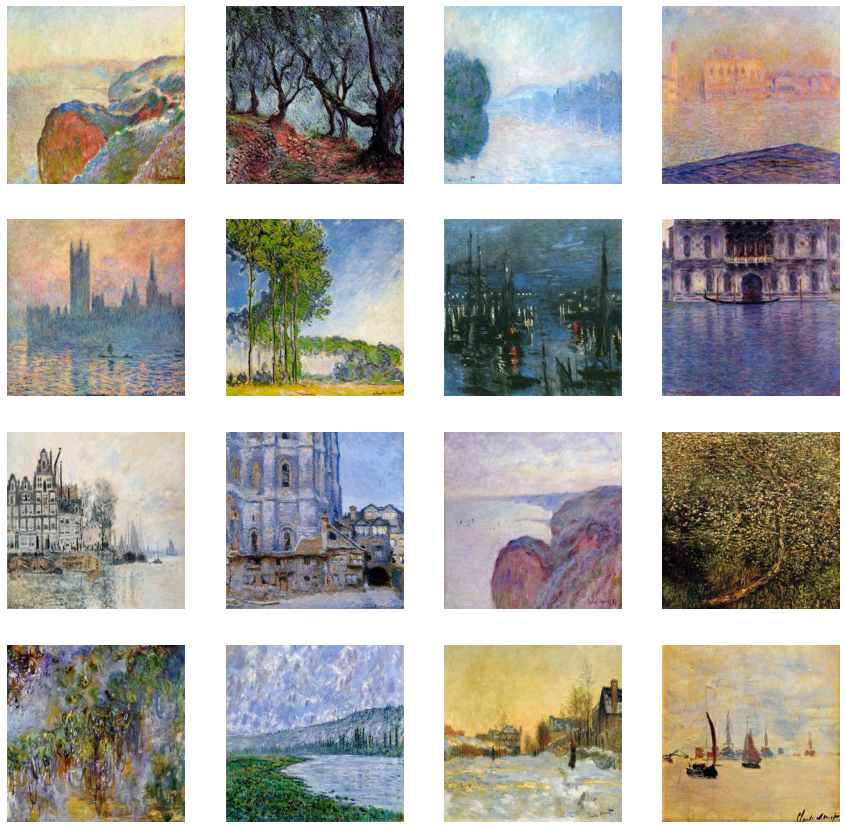

In [ ]:
display_samples(input_art, 4, 4)

### Sample Photos

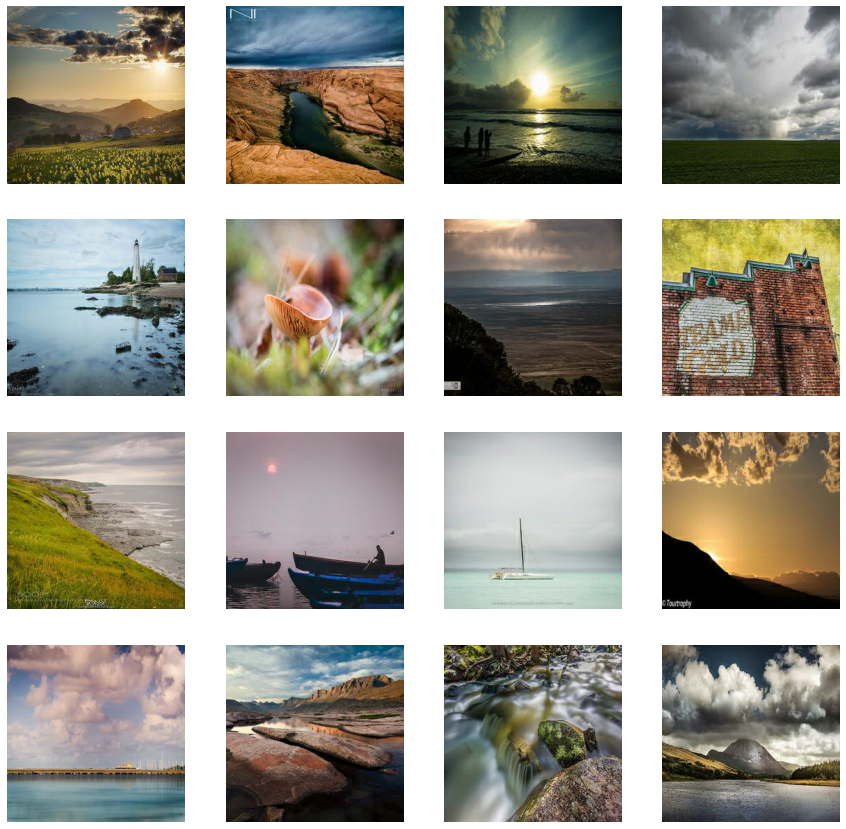

In [ ]:
display_samples(input_photo, 4, 4)

# Neural style transfer

Neural style transfer provide a way to compose one image in the style of another image and the technique is outlined in <a href="https://arxiv.org/abs/1508.06576" class="external">A Neural Algorithm of Artistic Style</a> (Gatys et al.). 

Neural style transfer is an optimization technique used to take two images

·A content image **($c$)** - the image we want to transfer a style to

·A style image **($s$)** - the image we want to transfer the style from

·A generated image **($g$)** - the image that contains the final result **(Only the trainable variables)**

![](https://assets-global.website-files.com/5d7b77b063a9066d83e1209c/613ebfc73d78bd3ecbe775c3_neural-style-transfer-model-architecture.png)

This is implemented by optimizing the output image to match the content statistics of the content image and the style statistics of the style reference image. These statistics are extracted from the images using a convolutional network.

## Setup


### Import and configure modules

In [ ]:
import os
import tensorflow as tf

In [ ]:
if input("Are you using Google Colab? y/n") in ['y','Y']:
    from google.colab import auth
    auth.authenticate_user()
    from googleapiclient.discovery import build
    drive_service = build('drive', 'v3')
    from google.colab import drive
    drive.mount('/content/drive', force_remount= True)
    input_art_dir='/content/drive/My Drive/Data/monet/monet_jpg'
    target_photo_dir='/content/drive/My Drive/Data/monet/photo_jpg'
else:
    input_art_dir='/Users/bryton/Desktop/Data/monet/monet_jpg'
    target_photo_dir='/Users/bryton/Desktop/Data/monet/photo_jpg'

input_art_paths = sorted(
    [os.path.join(input_art_dir, fname)
     for fname in os.listdir(input_art_dir)
     if fname.endswith(".jpg")])
input_photo_paths = sorted(
    [os.path.join(target_photo_dir, fname)
     for fname in os.listdir(target_photo_dir)
     if fname.endswith(".jpg")])

Are you using Google Colab? y/ny
Mounted at /content/drive


In [ ]:
import IPython.display as display

import matplotlib.pyplot as plt
import matplotlib as mpl
mpl.rcParams['figure.figsize'] = (12, 12)
mpl.rcParams['axes.grid'] = False

import numpy as np
import PIL.Image
import time
import functools

In [ ]:
def tensor_to_image(tensor):
    tensor = tensor*255
    tensor = np.array(tensor, dtype=np.uint8)
    if np.ndim(tensor)>3:
        assert tensor.shape[0] == 1
        tensor = tensor[0]
    return PIL.Image.fromarray(tensor)

Download images and choose a style image and a content image:

In [ ]:
import random
from tensorflow.keras.preprocessing.image import img_to_array, load_img, array_to_img

rand_photo = random.randint(0, 7038)
rand_art = random.randint(0, 300)

# Get content and style images
content_path = input_photo_paths[rand_photo]
style_path = style_art_path = input_art_paths[rand_art]

width, height = load_img(content_path).size
print(f"Input image dimensions: {width, height}")

Input image dimensions: (256, 256)


## Visualize the input

Define a function to load an image and limit its maximum dimension to 512 pixels.

In [ ]:
def load_img(path_to_img):
    max_dim = 512
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)

    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    long_dim = max(shape)
    scale = max_dim / long_dim

    new_shape = tf.cast(shape * scale, tf.int32)

    img = tf.image.resize(img, new_shape)
    img = img[tf.newaxis, :]
    return img

Create a simple function to display an image:

In [ ]:
def imshow(image, title=None):
    if len(image.shape) > 3:
        image = tf.squeeze(image, axis=0)

    plt.imshow(image)
    if title:
        plt.title(title)

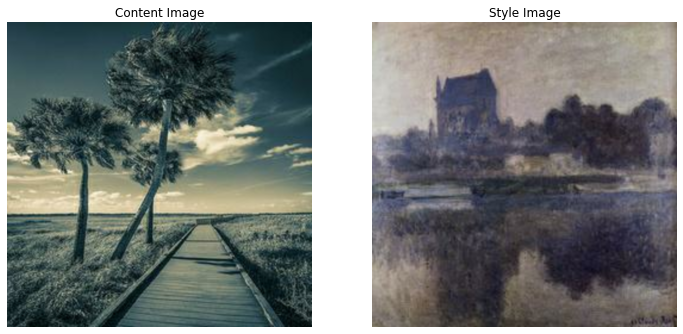

In [ ]:
content_image = load_img(content_path)
style_image = load_img(style_path)

plt.subplot(1, 2, 1)
plt.axis('off')
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
plt.axis('off')
imshow(style_image, 'Style Image')

## Define content and style representations

Use the intermediate layers of the model to get the **content** and **style** representations of the image. 

Starting from the network's input layer, the first few layer activations represent low-level features like edges and textures. In this case, we are using the VGG19 network architecture, a pretrained image classification network. These intermediate layers are necessary to define the representation of content and style from the images. For an input image, try to match the corresponding style and content target representations at these intermediate layers.


Load a [VGG19](https://keras.io/api/applications/vgg/#vgg19-function) and test run it on our image to ensure it's used correctly:

In [ ]:
x = tf.keras.applications.vgg19.preprocess_input(content_image*255)
x = tf.image.resize(x, (224, 224))
vgg = tf.keras.applications.VGG19(include_top=True, weights='imagenet')
prediction_probabilities = vgg(x)
prediction_probabilities.shape

574726144/574710816 [==============================] - 3s 0us/step


TensorShape([1, 1000])

In [ ]:
predicted_top_5 = tf.keras.applications.vgg19.decode_predictions(prediction_probabilities.numpy())[0]
[(class_name, prob) for (number, class_name, prob) in predicted_top_5]

49152/35363 [=========================================] - 0s 0us/step


[('seashore', 0.33104235),
 ('breakwater', 0.08925473),
 ('tripod', 0.08356168),
 ('lakeside', 0.080954),
 ('sandbar', 0.048980255)]

Now load a **`VGG19`** without the classification head, and list the layer names

In [ ]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

print()
for layer in vgg.layers:
    print(layer.name)

80150528/80134624 [==============================] - 0s 0us/step

input_2
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


Choose intermediate layers from the network to represent the style and content of the image:


In [ ]:
content_layers = ['block5_conv2'] 

style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

#### Intermediate layers for style and content

So why do these intermediate outputs within our pretrained image classification network allow us to define style and content representations?

At a high level, in order for a network to perform image classification (which this network has been trained to do), it must understand the image. This requires taking the raw image as input pixels and building an internal representation that converts the raw image pixels into a complex understanding of the features present within the image.

This is also a reason why convolutional neural networks are able to generalize well: they’re able to capture the invariances and defining features within classes (e.g. cats vs. dogs) that are agnostic to background noise and other nuisances. Thus, somewhere between where the raw image is fed into the model and the output classification label, the model serves as a complex feature extractor. By accessing intermediate layers of the model, you're able to describe the content and style of input images.

## Bulid the model

In [ ]:
def vgg_layers(layer_names):
    """ Creates a vgg model that returns a list of intermediate output values."""
    # Load our model. Load pretrained VGG, trained on imagenet data
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False
  
    outputs = [vgg.get_layer(name).output for name in layer_names]

    model = tf.keras.Model([vgg.input], outputs)
    return model

And to create the model:

In [ ]:
style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255)

#Look at the statistics of each layer's output
for name, output in zip(style_layers, style_outputs):
    print(name)
    print("  shape: ", output.numpy().shape)
    print("  min: ", output.numpy().min())
    print("  max: ", output.numpy().max())
    print("  mean: ", output.numpy().mean())
    print()

block1_conv1
  shape:  (1, 512, 512, 64)
  min:  0.0
  max:  713.4157
  mean:  16.703432

block2_conv1
  shape:  (1, 256, 256, 128)
  min:  0.0
  max:  2139.7703
  mean:  88.50826

block3_conv1
  shape:  (1, 128, 128, 256)
  min:  0.0
  max:  6319.5347
  mean:  74.01542

block4_conv1
  shape:  (1, 64, 64, 512)
  min:  0.0
  max:  9175.681
  mean:  309.2429

block5_conv1
  shape:  (1, 32, 32, 512)
  min:  0.0
  max:  1591.6298
  mean:  20.86635



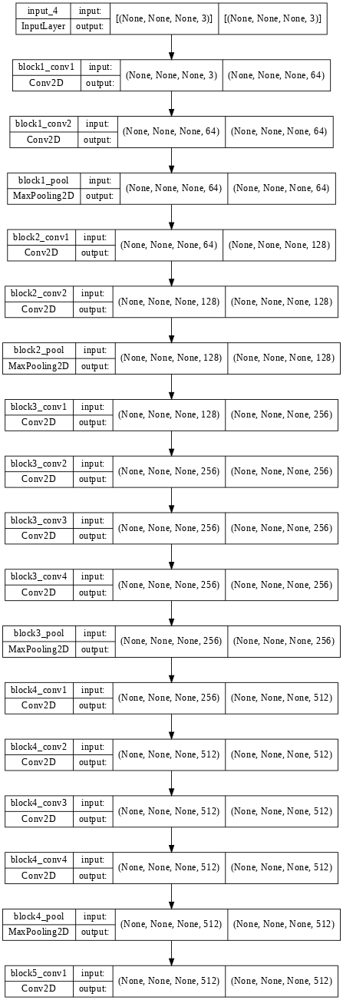

In [ ]:
tf.keras.utils.plot_model(style_extractor, show_shapes = True, dpi = 64)

## Calculate style

The content of an image is represented by the values of the intermediate feature maps.

It turns out, the style of an image can be described by the means and correlations across the different feature maps. Calculate a Gram matrix that includes this information by taking the outer product of the feature vector with itself at each location, and averaging that outer product over all locations. This Gram matrix can be calculated for a particular layer as:

$$G^l_{cd} = \frac{\sum_{ij} F^l_{ijc}(x)F^l_{ijd}(x)}{IJ}$$

This can be implemented concisely using the `tf.linalg.einsum` function:

In [ ]:
def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
    return result/(num_locations)

## Extract style and content


Build a model that returns the style and content tensors.

In [ ]:
class StyleContentModel(tf.keras.models.Model):
    def __init__(self, style_layers, content_layers):
        super(StyleContentModel, self).__init__()
        self.vgg = vgg_layers(style_layers + content_layers)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.vgg.trainable = False

    def call(self, inputs):
        """Expects float input in [0,1]"""
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs, content_outputs = (outputs[:self.num_style_layers],
                                          outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        content_dict = {content_name: value
                        for content_name, value
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name: value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}

        return {'content': content_dict, 'style': style_dict}

When called on an image, this model returns the gram matrix (style) of the `style_layers` and content of the `content_layers`:

In [ ]:
extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(content_image))

print('Styles:')
for name, output in sorted(results['style'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())
    print()

print("Contents:")
for name, output in sorted(results['content'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())


Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.0
    max:  14865.295
    mean:  336.3833

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  51457.184
    mean:  9700.57

   block3_conv1
    shape:  (1, 256, 256)
    min:  0.0
    max:  201048.06
    mean:  8382.694

   block4_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  1774343.2
    mean:  120784.734

   block5_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  59299.73
    mean:  783.7229

Contents:
   block5_conv2
    shape:  (1, 32, 32, 512)
    min:  0.0
    max:  847.85046
    mean:  9.944454


## Run gradient descent

With this style and content extractor, you can now implement the style transfer algorithm. Do this by calculating the mean square error for your image's output relative to each target, then take the weighted sum of these losses.

Set your style and content target values:

In [ ]:
style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

Define a `tf.Variable` to contain the image to optimize. To make this quick, initialize it with the content image (the `tf.Variable` must be the same shape as the content image):

In [ ]:
image = tf.Variable(content_image)

Since this is a float image, define a function to keep the pixel values between 0 and 1:

In [ ]:
def clip_0_1(image):
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

Create an optimizer. The paper recommends LBFGS, but `Adam` works okay, too:

In [ ]:
opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)

To optimize this, use a weighted combination of the two losses to get the total loss:

## The *Style Loss* , *Content Loss* and *Total Loss*

Let $A^l_{ij}(I)$ be the activation of the $l$ th layer, $i$ th feature map and $j$ th position obtained using the image I. The **Content Loss** function can be defined as follows:

$$L_{content} = \frac{1}{2}{\sum_{ij} (A^l_{ijc}(I)-A^l_{ijd}(I))^2}$$

Essentially $L_{content}$ captures the root mean squared error between the activations produced by the generated image and the content image. 

Similarly we can define **Style Loss** as:

$$L_{Style} = \frac{1}{2}{\sum_{ij} (G^l_{ijc}(I)-G^l_{ijd}(I))^2}$$

where $G^l_{ij}(I)$ be the **Gram_matrix** output of the $l$ th layer

Putting two together:

$$L_{Total} = \alpha*L_{content} + \beta*L_{Style}$$

Where $\alpha$ and $\beta$ is the weight of content loss and style loss in total loss function

In [ ]:
style_weight=1e-2
content_weight=1e4

In [ ]:
def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    loss = style_loss + content_loss
    return loss

## *Total variation loss*

One downside to this basic implementation is that it produces a lot of high frequency artifacts. Decrease these using an explicit regularization term on the high frequency components of the image. 

In style transfer, this is often called the *total variation loss*, which is a regularization loss to keep the generated image locally coherent.

In [ ]:
def high_pass_x_y(image):
    x_var = image[:, :, 1:, :] - image[:, :, :-1, :]
    y_var = image[:, 1:, :, :] - image[:, :-1, :, :]

    return x_var, y_var

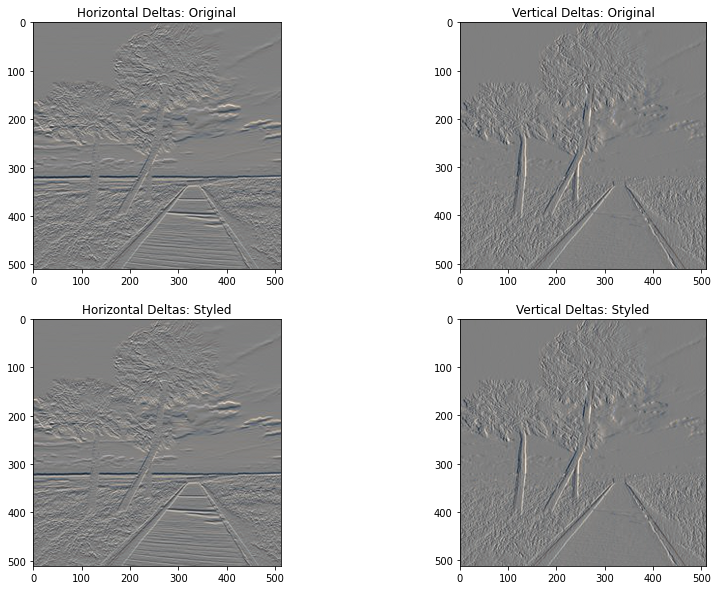

In [ ]:
x_deltas, y_deltas = high_pass_x_y(content_image)

plt.figure(figsize=(14, 10))
plt.subplot(2, 2, 1)
imshow(clip_0_1(2*y_deltas+0.5), "Horizontal Deltas: Original")

plt.subplot(2, 2, 2)
imshow(clip_0_1(2*x_deltas+0.5), "Vertical Deltas: Original")

x_deltas, y_deltas = high_pass_x_y(image)

plt.subplot(2, 2, 3)
imshow(clip_0_1(2*y_deltas+0.5), "Horizontal Deltas: Styled")

plt.subplot(2, 2, 4)
imshow(clip_0_1(2*x_deltas+0.5), "Vertical Deltas: Styled")

This shows how the high frequency components have increased.

Also, this high frequency component is basically an edge-detector. You can get similar output from the Sobel edge detector, for example:

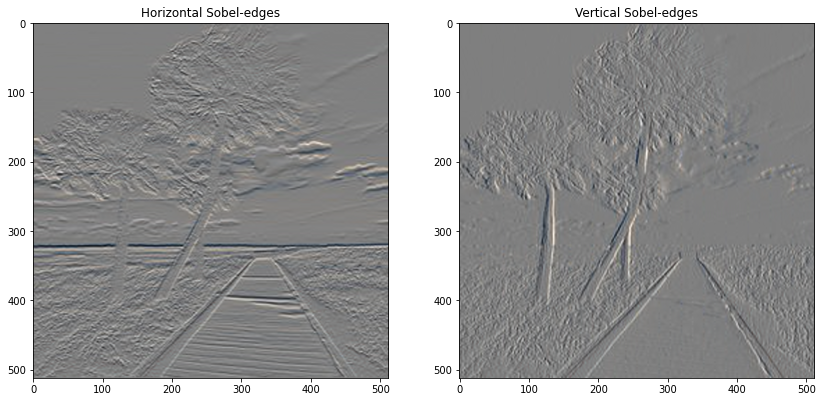

In [ ]:
plt.figure(figsize=(14, 10))

sobel = tf.image.sobel_edges(content_image)
plt.subplot(1, 2, 1)
imshow(clip_0_1(sobel[..., 0]/4+0.5), "Horizontal Sobel-edges")
plt.subplot(1, 2, 2)
imshow(clip_0_1(sobel[..., 1]/4+0.5), "Vertical Sobel-edges")

The regularization loss associated with this is the sum of the squares of the values:

In [ ]:
def total_variation_loss(image):
    x_deltas, y_deltas = high_pass_x_y(image)
    return tf.reduce_sum(tf.abs(x_deltas)) + tf.reduce_sum(tf.abs(y_deltas))

In [ ]:
total_variation_loss(image).numpy()

32347.35

Choose a weight for the `total_variation_loss`:

In [ ]:
total_variation_weight=30

Again, Total loss is defined as:

$$L_{Total} = \alpha*L_{content} + \beta*L_{Style} + \theta*L_{TotalVariationLoss}$$

Now include it in the `train_step` function:

In [ ]:
@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:
        outputs = extractor(image)
        loss = style_content_loss(outputs)
        loss += total_variation_weight*tf.image.total_variation(image)

    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))

Reinitialize the optimization variable:

In [ ]:
image = tf.Variable(content_image)

And run the optimization:

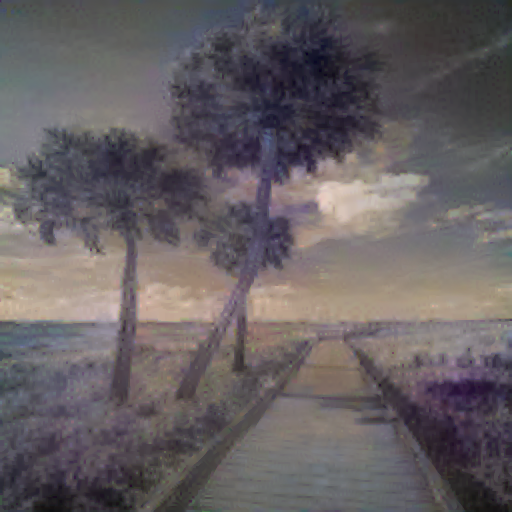

Train step: 1000
Total time: 92.2


In [ ]:
import time
start = time.time()

epochs = 10
steps_per_epoch = 100

step = 0
for n in range(epochs):
    for m in range(steps_per_epoch):
        step += 1
        train_step(image)
        print(".", end='', flush=True)
    display.clear_output(wait=True)
    display.display(tensor_to_image(image))
    print("Train step: {}".format(step))

end = time.time()
print("Total time: {:.1f}".format(end-start))

## Take a look on three pictures together

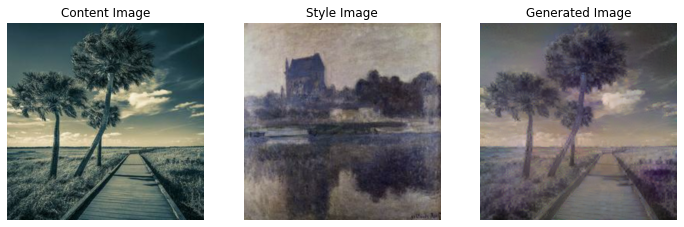

In [ ]:
plt.subplot(1, 3, 1)
plt.axis('off')
imshow(content_image, 'Content Image')

plt.subplot(1, 3, 2)
plt.axis('off')
imshow(style_image, 'Style Image')

plt.subplot(1, 3, 3)
plt.axis('off')
imshow(image, 'Generated Image')

# CycleGAN

## Introduction

CycleGAN uses a cycle consistency loss to enable training without the need for paired data. In other words, it can translate from one domain to another without a one-to-one mapping between the source and target domain.

This opens up the possibility to do a lot of interesting tasks like photo-enhancement, image colorization, style transfer, etc. All you need is the source and the target dataset (which is simply a directory of images).

A CycleGAN is actually composed of four models, two generators and two discriminators. The first generator, G_AB, converts images from domain A into domain B. The second generator, G_BA, converts images from domain B into domain A.

As we do not have paired images on which to train our generators, we also need to train two discriminators that will determine if the images produced by the generators are convincing. The first discriminator, d_A, is trained to be able to identify the difference between real images from domain A and fake images that have been produced by generator G_BA. Conversely, discriminator d_B is trained to be able to identify the difference between real images from domain B and fake images that have been produced by generator G_AB. The relationship between the four models is shown in Figure below.

![](https://hardikbansal.github.io/CycleGANBlog/images/model.jpg)

## Setup

This notebook utilizes a CycleGAN architecture to add Monet-style to photos. Import the following packages.

In [ ]:
!pip install tensorflow_addons

     |████████████████████████████████| 1.1 MB 7.8 MB/s 


In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import tensorflow_addons as tfa

import matplotlib.pyplot as plt
import numpy as np

strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.experimental.AUTOTUNE
    
print(tf.__version__)

Number of replicas: 1
2.8.0


## Load in the data

We want to keep our photo dataset and our Monet dataset separate. First, load in the filenames of the TFRecords.

In [ ]:
# GCS_PATH = KaggleDatasets().get_gcs_path()
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"yuxinsong123","key":"614371b2186ec5ee69c6c91c326c7527"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

!kaggle competitions download -c gan-getting-started

 98% 361M/367M [00:02<00:00, 181MB/s]
100% 367M/367M [00:02<00:00, 160MB/s]


In [ ]:
!unzip -qq gan-getting-started.zip

In [ ]:
MONET_FILENAMES = tf.io.gfile.glob(str('/content/monet_tfrec/*.tfrec'))
print('Monet TFRecord Files:', len(MONET_FILENAMES))

PHOTO_FILENAMES = tf.io.gfile.glob(str('/content/photo_tfrec/*.tfrec'))
print('Photo TFRecord Files:', len(PHOTO_FILENAMES))

Monet TFRecord Files: 5
Photo TFRecord Files: 20


All the images for the competition are already sized to 256x256. As these images are RGB images, set the channel to 3. Additionally, we need to scale the images to a [-1, 1] scale. Because we are building a generative model, we don't need the labels or the image id so we'll only return the image from the TFRecord.

In [ ]:
IMAGE_SIZE = [256, 256]

def decode_image(image):
    image = tf.image.decode_jpeg(image, channels=3)
    image = (tf.cast(image, tf.float32) / 127.5) - 1
    image = tf.reshape(image, [*IMAGE_SIZE, 3])
    return image

def read_tfrecord(example):
    tfrecord_format = {
        "image_name": tf.io.FixedLenFeature([], tf.string),
        "image": tf.io.FixedLenFeature([], tf.string),
        "target": tf.io.FixedLenFeature([], tf.string)
    }
    example = tf.io.parse_single_example(example, tfrecord_format)
    image = decode_image(example['image'])
    return image

Define the function to extract the image from the files.

In [ ]:
def load_dataset(filenames, labeled=True, ordered=False):
    dataset = tf.data.TFRecordDataset(filenames)
    dataset = dataset.map(read_tfrecord, num_parallel_calls=AUTOTUNE)
    return dataset

Let's load in our datasets.

In [ ]:
monet_ds = load_dataset(MONET_FILENAMES, labeled=True).batch(1)
photo_ds = load_dataset(PHOTO_FILENAMES, labeled=True).batch(1)

In [ ]:
example_monet = next(iter(monet_ds))
example_photo = next(iter(photo_ds))

Let's  visualize a photo example and a Monet example.

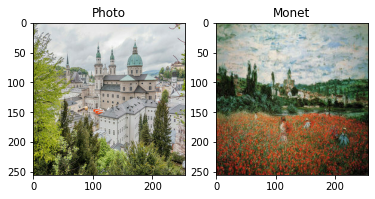

In [ ]:
plt.subplot(121)
plt.title('Photo')
plt.imshow(example_photo[0] * 0.5 + 0.5)

plt.subplot(122)
plt.title('Monet')
plt.imshow(example_monet[0] * 0.5 + 0.5)

## Build the generator

We'll be using a U-NET architecture for our CycleGAN. A U-Net consists of an encoder (downsampler) and decoder (upsampler). To build our generator, let's first define our `downsample` and `upsample` methods.

The `downsample`, as the name suggests, reduces the 2D dimensions, the width and height, of the image by the stride. The stride is the length of the step the filter takes. Since the stride is 2, the filter is applied to every other pixel, hence reducing the weight and height by 2.

We'll be using an instance normalization instead of batch normalization. As the instance normalization is not standard in the TensorFlow API, we'll use the layer from TensorFlow Addons.

In [ ]:
OUTPUT_CHANNELS = 3

def downsample(filters, size, apply_instancenorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

    result = keras.Sequential()
    result.add(layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

    if apply_instancenorm:
        result.add(tfa.layers.InstanceNormalization(gamma_initializer=gamma_init))

    result.add(layers.LeakyReLU())

    return result

`Upsample` does the opposite of downsample and increases the dimensions of the of the image. `Conv2DTranspose` does basically the opposite of a `Conv2D` layer.

In [ ]:
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

    result = keras.Sequential()
    result.add(layers.Conv2DTranspose(filters, size, strides=2,
                                      padding='same',
                                      kernel_initializer=initializer,
                                      use_bias=False))

    result.add(tfa.layers.InstanceNormalization(gamma_initializer=gamma_init))

    if apply_dropout:
        result.add(layers.Dropout(0.5))

    result.add(layers.ReLU())

    return result

Build our generator

The generator first downsamples the input image and then upsample while establishing long skip connections. Skip connections are a way to help bypass the vanishing gradient problem by concatenating the output of a layer to multiple layers instead of only one. Here we concatenate the output of the downsample layer to the upsample layer in a symmetrical fashion.

There is a simple example of U-net
![](https://lmb.informatik.uni-freiburg.de/people/ronneber/u-net/u-net-architecture.png)

In [ ]:
def Generator():
    inputs = layers.Input(shape=[256,256,3])

    # bs = batch size
    down_stack = [
        downsample(64, 4, apply_instancenorm=False), # (bs, 128, 128, 64)
        downsample(128, 4), # (bs, 64, 64, 128)
        downsample(256, 4), # (bs, 32, 32, 256)
        downsample(512, 4), # (bs, 16, 16, 512)
        downsample(512, 4), # (bs, 8, 8, 512)
        downsample(512, 4), # (bs, 4, 4, 512)
        downsample(512, 4), # (bs, 2, 2, 512)
        downsample(512, 4), # (bs, 1, 1, 512)
    ]

    up_stack = [
        upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 1024)
        upsample(512, 4, apply_dropout=True), # (bs, 4, 4, 1024)
        upsample(512, 4, apply_dropout=True), # (bs, 8, 8, 1024)
        upsample(512, 4), # (bs, 16, 16, 1024)
        upsample(256, 4), # (bs, 32, 32, 512)
        upsample(128, 4), # (bs, 64, 64, 256)
        upsample(64, 4), # (bs, 128, 128, 128)
    ]

    initializer = tf.random_normal_initializer(0., 0.02)
    last = layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                  strides=2,
                                  padding='same',
                                  kernel_initializer=initializer,
                                  activation='tanh') # (bs, 256, 256, 3)

    x = inputs

    # Downsampling through the model
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    skips = reversed(skips[:-1])

    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        x = layers.Concatenate()([x, skip])

    x = last(x)

    return keras.Model(inputs=inputs, outputs=x)

In [ ]:
cycleGAN_generator = Generator()
cycleGAN_generator.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 sequential_51 (Sequential)     (None, 128, 128, 64  3072        ['input_4[0][0]']                
                                )                                                                 
                                                                                                  
 sequential_52 (Sequential)     (None, 64, 64, 128)  131328      ['sequential_51[0][0]']          
                                                                                            

This plot shows the architecture of the U-Net generator model we will be using

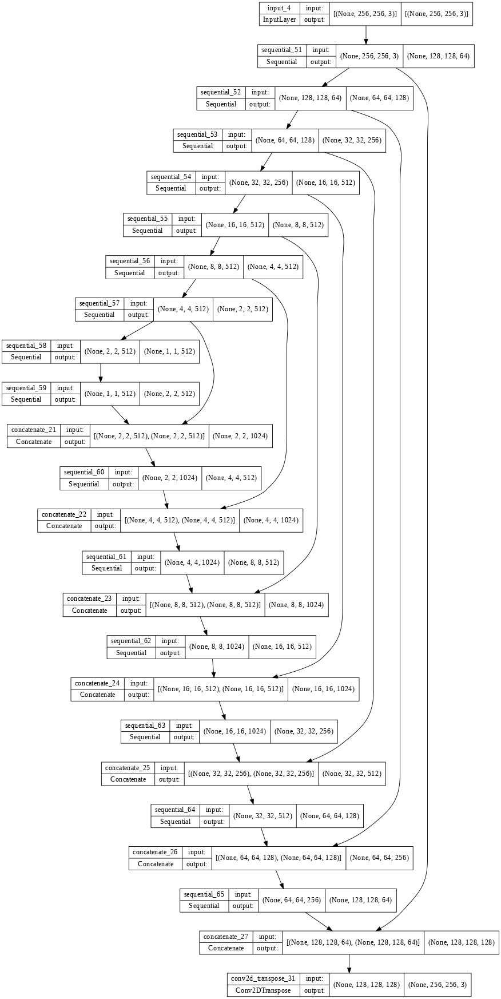

In [ ]:
tf.keras.utils.plot_model(cycleGAN_generator, show_shapes = True, dpi = 64)

## Build the discriminator

The discriminator takes in the input image and classifies it as real or fake (generated). Instead of outputing a single node, the discriminator outputs a smaller 2D image with higher pixel values indicating a real classification and lower values indicating a fake classification.

In [ ]:
def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    gamma_init = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)

    inp = layers.Input(shape=[256, 256, 3], name='input_image')

    x = inp

    down1 = downsample(64, 4, False)(x) # (bs, 128, 128, 64)
    down2 = downsample(128, 4)(down1) # (bs, 64, 64, 128)
    down3 = downsample(256, 4)(down2) # (bs, 32, 32, 256)

    zero_pad1 = layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
    conv = layers.Conv2D(512, 4, strides=1,
                         kernel_initializer=initializer,
                         use_bias=False)(zero_pad1) # (bs, 31, 31, 512)

    norm1 = tfa.layers.InstanceNormalization(gamma_initializer=gamma_init)(conv)

    leaky_relu = layers.LeakyReLU()(norm1)

    zero_pad2 = layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

    last = layers.Conv2D(1, 4, strides=1,
                         kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

    return tf.keras.Model(inputs=inp, outputs=last)

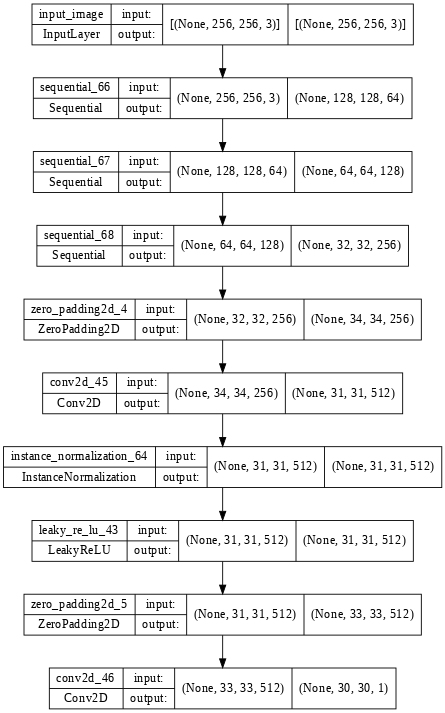

In [ ]:
cycleGAN_discriminator = Discriminator()
tf.keras.utils.plot_model(cycleGAN_discriminator, show_shapes=True, dpi=64)

In [ ]:
with strategy.scope():
    monet_generator = Generator() # transforms photos to Monet-esque paintings
    photo_generator = Generator() # transforms Monet paintings to be more like photos

    monet_discriminator = Discriminator() # differentiates real Monet paintings and generated Monet paintings
    photo_discriminator = Discriminator() # differentiates real photos and generated photos

Since our generators are not trained yet, the generated Monet-esque photo does not show what is expected at this point.

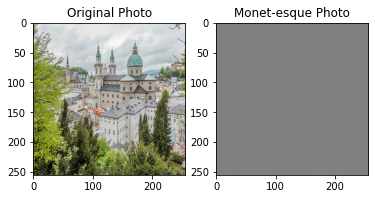

In [ ]:
to_monet = monet_generator(example_photo)

plt.subplot(1, 2, 1)
plt.title("Original Photo")
plt.imshow(example_photo[0] * 0.5 + 0.5)

plt.subplot(1, 2, 2)
plt.title("Monet-esque Photo")
plt.imshow(to_monet[0] * 0.5 + 0.5)
plt.show()

## Build the CycleGAN model

We will subclass a `tf.keras.Model` so that we can run `fit()` later to train our model. During the training step, the model transforms a photo to a Monet painting and then back to a photo. The difference between the original photo and the twice-transformed photo is the cycle-consistency loss. We want the original photo and the twice-transformed photo to be similar to one another.

The losses are defined in the next section.

In [ ]:
class CycleGan(keras.Model):
    def __init__(
        self,
        monet_generator,
        photo_generator,
        monet_discriminator,
        photo_discriminator,
        lambda_cycle=10,
    ):
        super(CycleGan, self).__init__()
        self.m_gen = monet_generator
        self.p_gen = photo_generator
        self.m_disc = monet_discriminator
        self.p_disc = photo_discriminator
        self.lambda_cycle = lambda_cycle
        
    def compile(
        self,
        m_gen_optimizer,
        p_gen_optimizer,
        m_disc_optimizer,
        p_disc_optimizer,
        gen_loss_fn,
        disc_loss_fn,
        cycle_loss_fn,
        identity_loss_fn
    ):
        super(CycleGan, self).compile()
        self.m_gen_optimizer = m_gen_optimizer
        self.p_gen_optimizer = p_gen_optimizer
        self.m_disc_optimizer = m_disc_optimizer
        self.p_disc_optimizer = p_disc_optimizer
        self.gen_loss_fn = gen_loss_fn
        self.disc_loss_fn = disc_loss_fn
        self.cycle_loss_fn = cycle_loss_fn
        self.identity_loss_fn = identity_loss_fn
        
    def train_step(self, batch_data):
        real_monet, real_photo = batch_data
        
        with tf.GradientTape(persistent=True) as tape:
            # photo to monet back to photo
            fake_monet = self.m_gen(real_photo, training=True)
            cycled_photo = self.p_gen(fake_monet, training=True)

            # monet to photo back to monet
            fake_photo = self.p_gen(real_monet, training=True)
            cycled_monet = self.m_gen(fake_photo, training=True)

            # generating itself
            same_monet = self.m_gen(real_monet, training=True)
            same_photo = self.p_gen(real_photo, training=True)

            # discriminator used to check, inputing real images
            disc_real_monet = self.m_disc(real_monet, training=True)
            disc_real_photo = self.p_disc(real_photo, training=True)

            # discriminator used to check, inputing fake images
            disc_fake_monet = self.m_disc(fake_monet, training=True)
            disc_fake_photo = self.p_disc(fake_photo, training=True)

            # evaluates generator loss
            monet_gen_loss = self.gen_loss_fn(disc_fake_monet)
            photo_gen_loss = self.gen_loss_fn(disc_fake_photo)

            # evaluates total cycle consistency loss
            total_cycle_loss = self.cycle_loss_fn(real_monet, cycled_monet, self.lambda_cycle) + self.cycle_loss_fn(real_photo, cycled_photo, self.lambda_cycle)

            # evaluates total generator loss
            total_monet_gen_loss = monet_gen_loss + total_cycle_loss + self.identity_loss_fn(real_monet, same_monet, self.lambda_cycle)
            total_photo_gen_loss = photo_gen_loss + total_cycle_loss + self.identity_loss_fn(real_photo, same_photo, self.lambda_cycle)

            # evaluates discriminator loss
            monet_disc_loss = self.disc_loss_fn(disc_real_monet, disc_fake_monet)
            photo_disc_loss = self.disc_loss_fn(disc_real_photo, disc_fake_photo)

        # Calculate the gradients for generator and discriminator
        monet_generator_gradients = tape.gradient(total_monet_gen_loss,
                                                  self.m_gen.trainable_variables)
        photo_generator_gradients = tape.gradient(total_photo_gen_loss,
                                                  self.p_gen.trainable_variables)

        monet_discriminator_gradients = tape.gradient(monet_disc_loss,
                                                      self.m_disc.trainable_variables)
        photo_discriminator_gradients = tape.gradient(photo_disc_loss,
                                                      self.p_disc.trainable_variables)

        # Apply the gradients to the optimizer
        self.m_gen_optimizer.apply_gradients(zip(monet_generator_gradients,
                                                 self.m_gen.trainable_variables))

        self.p_gen_optimizer.apply_gradients(zip(photo_generator_gradients,
                                                 self.p_gen.trainable_variables))

        self.m_disc_optimizer.apply_gradients(zip(monet_discriminator_gradients,
                                                  self.m_disc.trainable_variables))

        self.p_disc_optimizer.apply_gradients(zip(photo_discriminator_gradients,
                                                  self.p_disc.trainable_variables))
        
        return {
            "monet_gen_loss": total_monet_gen_loss,
            "photo_gen_loss": total_photo_gen_loss,
            "monet_disc_loss": monet_disc_loss,
            "photo_disc_loss": photo_disc_loss
        }

## Define loss functions

The discriminator loss function below compares real images to a matrix of 1s and fake images to a matrix of 0s. The perfect discriminator will output all 1s for real images and all 0s for fake images. The discriminator loss outputs the average of the real and generated loss.

![](https://raw.githubusercontent.com/tensorflow/docs/master/site/en/tutorials/generative/images/dis.png)

In [ ]:
with strategy.scope():
    def discriminator_loss(real, generated):
        real_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)(tf.ones_like(real), real)

        generated_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)(tf.zeros_like(generated), generated)

        total_disc_loss = real_loss + generated_loss

        return total_disc_loss * 0.5

The generator wants to fool the discriminator into thinking the generated image is real. The perfect generator will have the discriminator output only 1s. Thus, it compares the generated image to a matrix of 1s to find the loss.

![](https://raw.githubusercontent.com/tensorflow/docs/master/site/en/tutorials/generative/images/gen.png)

In [ ]:
with strategy.scope():
    def generator_loss(generated):
        return tf.keras.losses.BinaryCrossentropy(from_logits=True, reduction=tf.keras.losses.Reduction.NONE)(tf.ones_like(generated), generated)

Then is the cycle consistency loss which is the key part of cycleGAN.

Cycle consistency means the result should be close to the original input. We want our original photo and the twice transformed photo to be similar to one another. Thus, we can calculate the cycle consistency loss by finding the average of their difference.


*   Image X is passed via generator G that yields generated image Fake(Y)

*   Generated image Fake(Y) is passed via generator F that yields cycled image Fake(X)

*   Mean absolute error is calculated between X and Fake(X)

![](https://www.tensorflow.org/tutorials/generative/images/cycle_loss.png)



In [ ]:
with strategy.scope():
    def calc_cycle_loss(real_image, cycled_image, LAMBDA):
        loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))

        return LAMBDA * loss1

The identity loss compares the image with its generator (i.e. photo with photo generator). If given a photo as input, we want it to generate the same image as the image was originally a photo. The identity loss compares the input with the output of the generator.

$Identity \ Loss= \mid G(Y) - Y \mid + \mid F(X) - X \mid$

In [ ]:
with strategy.scope():
    def identity_loss(real_image, same_image, LAMBDA):
        loss = tf.reduce_mean(tf.abs(real_image - same_image))
        return LAMBDA * 0.5 * loss

## Train the CycleGAN

Let's compile our model. Since we used `tf.keras.Model` to build our CycleGAN, we can just use the `fit` function to train our model.

In [ ]:
with strategy.scope():
    monet_generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    photo_generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

    monet_discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
    photo_discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [ ]:
with strategy.scope():
    cycle_gan_model = CycleGan(
        monet_generator, photo_generator, monet_discriminator, photo_discriminator
    )

    cycle_gan_model.compile(
        m_gen_optimizer = monet_generator_optimizer,
        p_gen_optimizer = photo_generator_optimizer,
        m_disc_optimizer = monet_discriminator_optimizer,
        p_disc_optimizer = photo_discriminator_optimizer,
        gen_loss_fn = generator_loss,
        disc_loss_fn = discriminator_loss,
        cycle_loss_fn = calc_cycle_loss,
        identity_loss_fn = identity_loss
    )

In [ ]:
cycle_gan_model.fit(
    tf.data.Dataset.zip((monet_ds, photo_ds)),
    epochs=100
)

Epoch 1/100
300/300 [==============================] - 113s 248ms/step - monet_gen_loss: 5.0433 - photo_gen_loss: 5.1723 - monet_disc_loss: 0.6525 - photo_disc_loss: 0.6390
Epoch 2/100
300/300 [==============================] - 74s 246ms/step - monet_gen_loss: 3.5653 - photo_gen_loss: 3.6169 - monet_disc_loss: 0.6643 - photo_disc_loss: 0.6506
Epoch 3/100
300/300 [==============================] - 74s 248ms/step - monet_gen_loss: 3.4529 - photo_gen_loss: 3.6071 - monet_disc_loss: 0.6647 - photo_disc_loss: 0.6020
Epoch 4/100
300/300 [==============================] - 74s 248ms/step - monet_gen_loss: 3.3604 - photo_gen_loss: 3.5598 - monet_disc_loss: 0.6481 - photo_disc_loss: 0.5918
Epoch 5/100
300/300 [==============================] - 74s 248ms/step - monet_gen_loss: 3.2859 - photo_gen_loss: 3.4641 - monet_disc_loss: 0.6362 - photo_disc_loss: 0.5997
Epoch 6/100
300/300 [==============================] - 74s 247ms/step - monet_gen_loss: 3.1843 - photo_gen_loss: 3.3080 - monet_disc_loss: 

## Visualize our Monet-esque photos

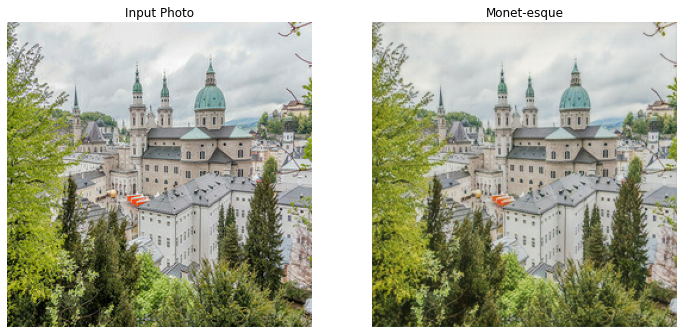

Generate another monet style photo? y/ny


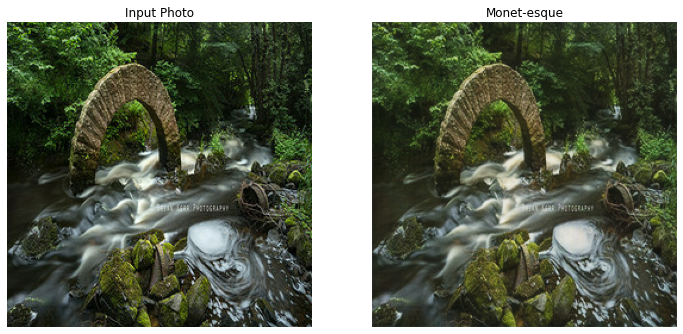

Generate another monet style photo? y/n


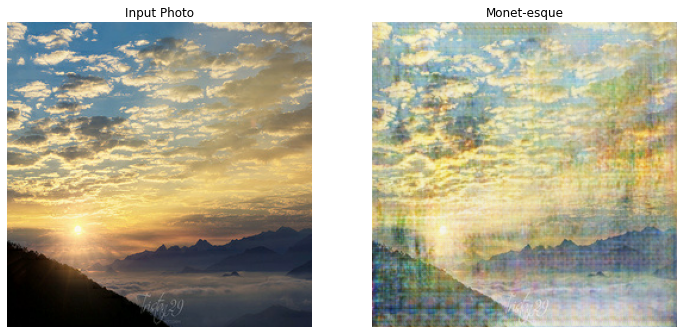

Generate another monet style photo? y/ny


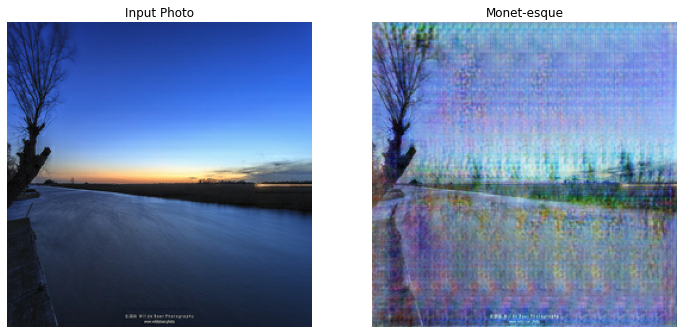

Generate another monet style photo? y/ny


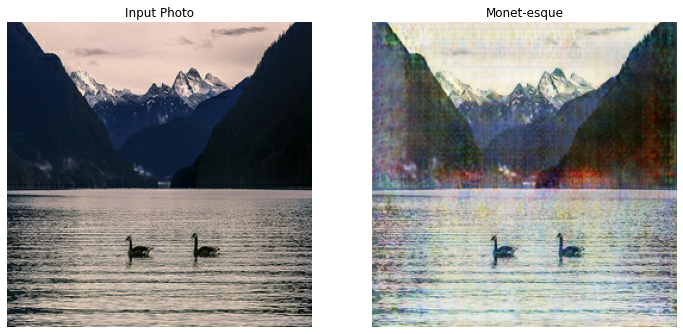

Generate another monet style photo? y/ny


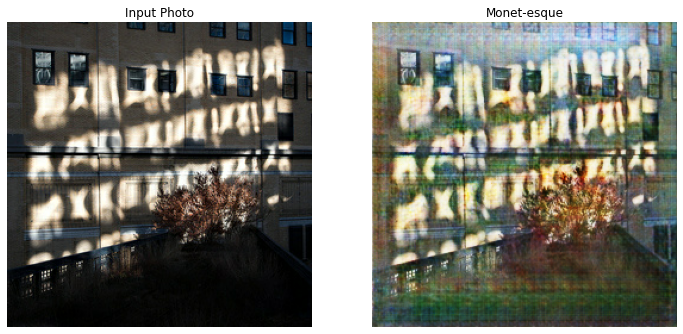

Generate another monet style photo? y/ny


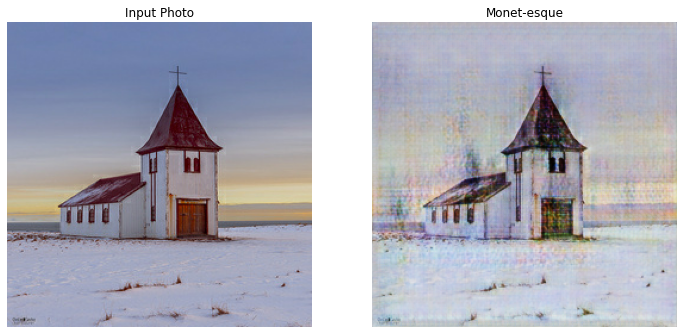

Generate another monet style photo? y/ny


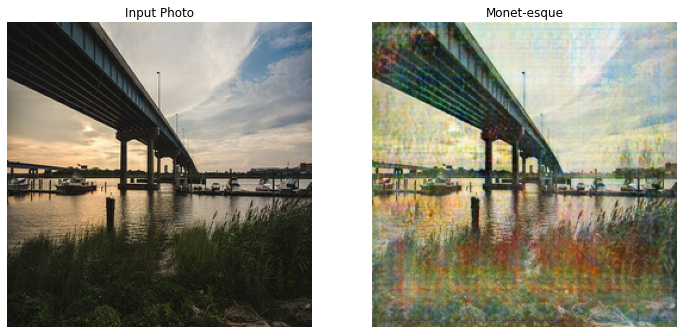

Generate another monet style photo? y/nn


In [ ]:
import time

# _, ax = plt.subplots(1, 2, figsize=(12, 12))

for img in photo_ds:
    prediction = monet_generator(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    plt.figure(figsize=(12, 12))
    plt.subplot(1,2,1)
    plt.imshow(img)
    plt.title("Input Photo")
    plt.axis("off")
    plt.subplot(1,2,2)
    plt.imshow(prediction)
    plt.title("Monet-esque")
    plt.axis("off")
    plt.show()

    time.sleep(2)
    if input('Generate another monet style photo? y/n')=='n':
        break

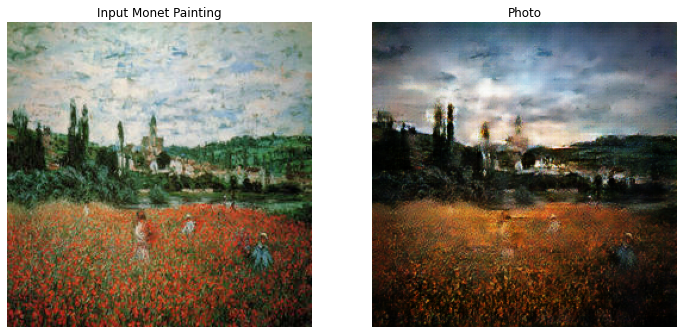

Generate another photo? y/ny


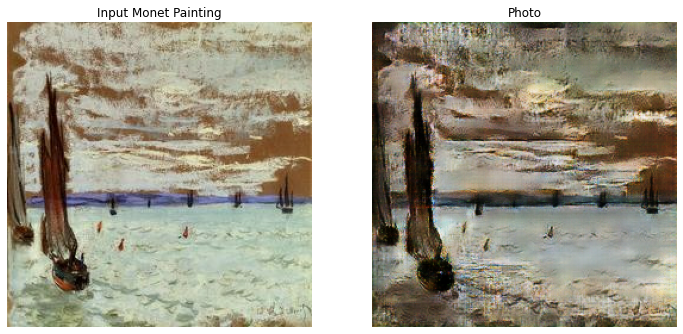

Generate another photo? y/n


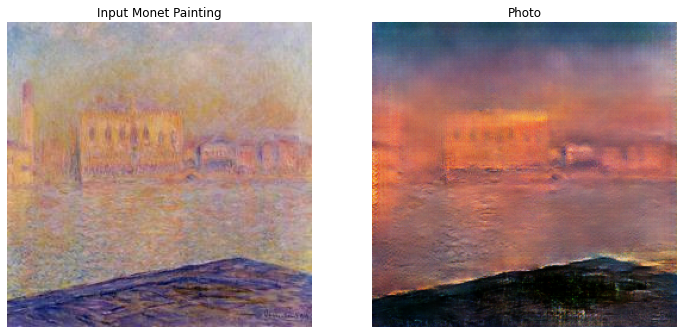

Generate another photo? y/ny


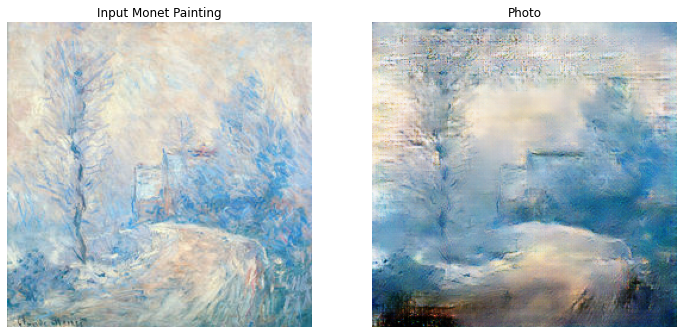

Generate another photo? y/ny


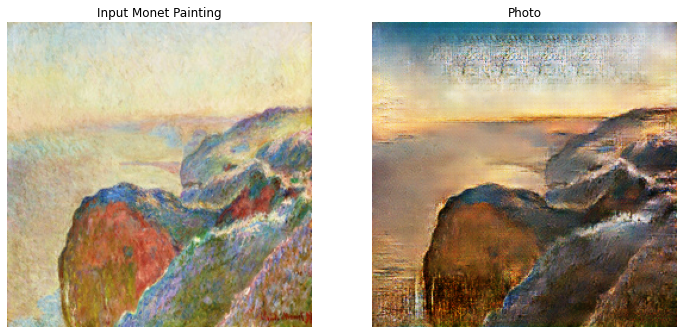

Generate another photo? y/n


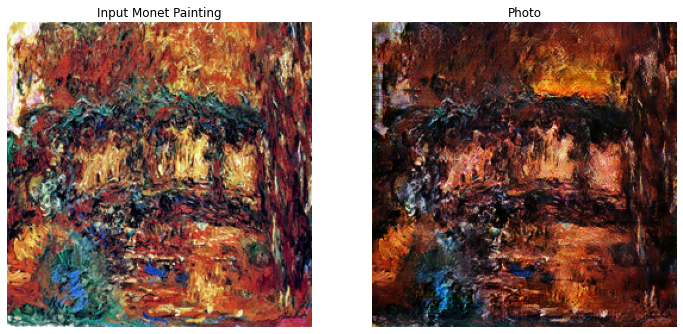

Generate another photo? y/ny


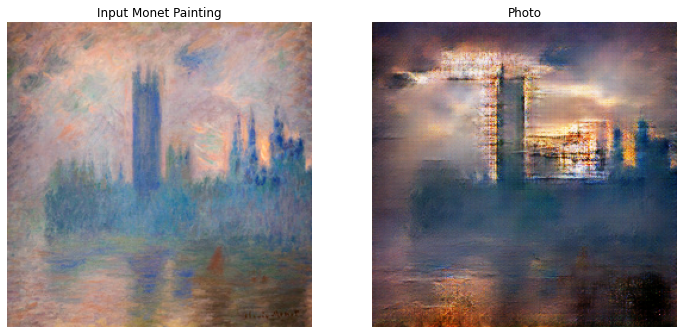

Generate another photo? y/nn


In [ ]:
 for img in monet_ds:
    prediction = photo_generator(img, training=False)[0].numpy()
    prediction = (prediction * 127.5 + 127.5).astype(np.uint8)
    img = (img[0] * 127.5 + 127.5).numpy().astype(np.uint8)

    plt.figure(figsize=(12, 12))
    plt.subplot(1,2,1)
    plt.imshow(img)
    plt.title("Input Monet Painting")
    plt.axis("off")
    plt.subplot(1,2,2)
    plt.imshow(prediction)
    plt.title("Photo")
    plt.axis("off")
    plt.show()

    time.sleep(2)
    if input('Generate another photo? y/n')=='n':
        break

# StyleALAE

## Introduction

StyleALAE uses the StyleGAN based generator along with the Adversarial Latent Autoencoder(ALAE introduces an Autoencoder architecture that is general, and has generative power comparable to GANs while learning a less entangled representation.). The architecture is shown as the picture below.

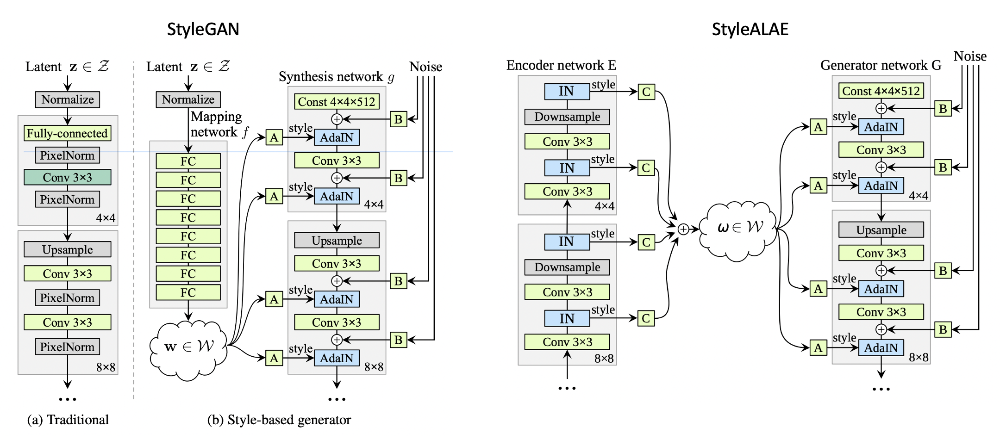

The traditional generator feeds the latent code though the input layer only, but styleGAN first map the input to an intermediate latent space W, which then controls the generator through adaptive instance normalization (AdaIN) at each convolution layer. 

StyleALAE's latent space W play the same role as the intermediate latent space in StyleGAN. The generator network G becomes the part of StyleGAN depicted on the right side of the figure. The left side is the encoder network E.

The encoder is designed symmetrically to the generator network so as to capture style information from the image.In the encoder network, the Instance Normalization Layers are added to get the mean and standard deviations for every channel, effectively pulling out the style representation from each level. Then we can apply it to corresponding layer.

## Set up

In [ ]:
!pip install tensorflow_addons # install tensorflow addons

     |████████████████████████████████| 1.1 MB 5.2 MB/s 


In [ ]:
from __future__ import absolute_import, division, print_function, unicode_literals

import tensorflow as tf
import tensorflow_addons as tfa
import logging

import numpy as np 
import pandas as pd 
import time
import random
import sys
from tensorflow.keras.utils import plot_model

import matplotlib.pyplot as plt
from IPython import display
from IPython.display import clear_output

AUTOTUNE = tf.data.experimental.AUTOTUNE

In [ ]:
# set the seed and the session configure parameters
seed=123
tf.compat.v1.set_random_seed(seed)
session_conf = tf.compat.v1.ConfigProto(intra_op_parallelism_threads=1, inter_op_parallelism_threads=1)
sess = tf.compat.v1.Session(graph=tf.compat.v1.get_default_graph(), config=session_conf)
tf.compat.v1.keras.backend.set_session(sess)
logging.disable(sys.maxsize)

In [ ]:
BUFFER_SIZE = 10
BATCH_SIZE = 1
IMG_WIDTH = 256
IMG_HEIGHT = 256
OUTPUT_CHANNELS = 3
EPOCHS = 2500
LAMBDA = 10
GAMMA = 10
noise_dim = 100

## Load the data

### Download the data from Kaggle 

In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"brytonli","key":"d140aecc700ed5ce5e26723b9bcb6b98"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle competitions download -c gan-getting-started

 95% 348M/367M [00:01<00:00, 217MB/s]
100% 367M/367M [00:02<00:00, 168MB/s]


In [ ]:
!unzip -qq gan-getting-started.zip

### Load and process the data

In [ ]:
input_art_dir= '/content/monet_jpg'
target_photo_dir= '/content/photo_jpg'

input_art_paths = np.array(sorted(
    [os.path.join(input_art_dir, fname)
     for fname in os.listdir(input_art_dir)
     if fname.endswith(".jpg")]))
input_photo_paths = np.array(sorted(
    [os.path.join(target_photo_dir, fname)
     for fname in os.listdir(target_photo_dir)
     if fname.endswith(".jpg")]))

In [ ]:
ImageSet_1 = input_art_paths
ImageSet_2 = input_photo_paths

In [ ]:
def load(image_file):
    image = tf.io.read_file(image_file)
    image = tf.image.decode_jpeg(image)

    image_ = tf.cast(image, tf.float32)
    return image_

In [ ]:
def resize(input_, height, width):
    img_ = tf.image.resize(input_, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)    
    return img_

In [ ]:
# normalizing the images to [-1, 1]
def normalize(input_):
    image = tf.cast(input_, tf.float32)
    img_ = (image / 127.5) - 1
   
    return img_

In [ ]:
@tf.function()
def random_jitter(input_):
    img_ = resize(input_,IMG_HEIGHT, IMG_WIDTH)

    if tf.random.uniform(()) > 0.5:
        img_ = tf.image.flip_left_right(img_)

    return img_

In [ ]:
def load_image_train(file_):
    input_ = load(file_)
    img_ = random_jitter(input_)
    img_ = normalize(img_)

    return img_

In [ ]:
train_source = (
    tf.data.Dataset
    .from_tensor_slices((ImageSet_1))
    .map(load_image_train, num_parallel_calls=AUTOTUNE)
    .shuffle(7)
    .batch(BATCH_SIZE)
)
train_dest = (
    tf.data.Dataset
    .from_tensor_slices((ImageSet_2))
    .map(load_image_train, num_parallel_calls=AUTOTUNE)
    .shuffle(7)
    .batch(BATCH_SIZE)
)

In [ ]:
def noise_(num, filter, noise):
    noise_layer = tf.keras.layers.Dense(num*num*filter)(noise)
    noise_layer = tfa.layers.InstanceNormalization()(noise_layer)
    noise_layer = tf.keras.layers.ReLU()(noise_layer)

    reshape_noise = tf.keras.layers.Reshape((num, num, filter))(noise_layer)

    return reshape_noise

## Visulize Source Set

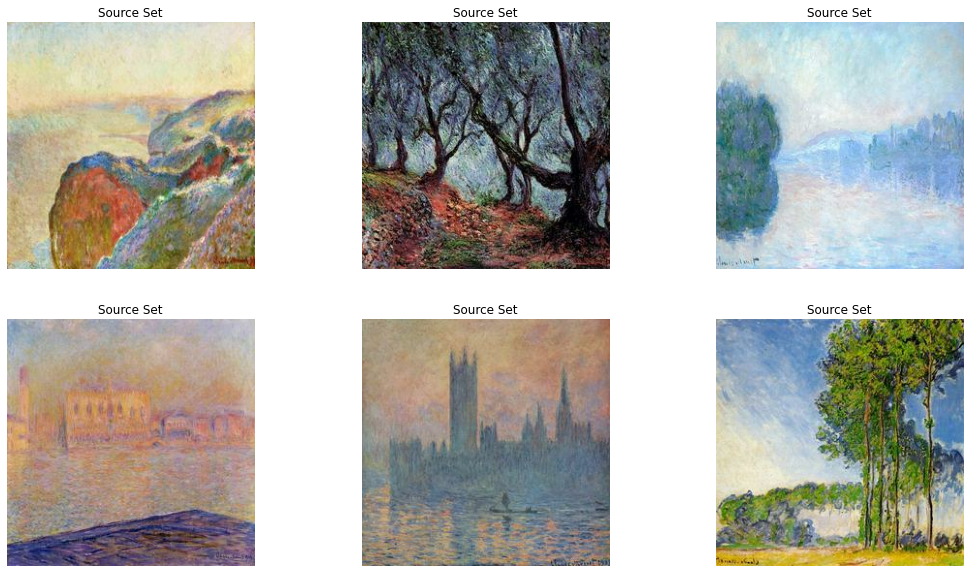

In [ ]:
source = []
dest = []
for x,y in zip(ImageSet_1,ImageSet_2):
    source.append(load_image_train(x))
    dest.append(load_image_train(y))
fig, axis = plt.subplots(2, 3, figsize=(18, 10))
for i, ax in enumerate(axis.flat):
    ax.imshow(source[i] * 0.5 + 0.5)
    ax.set(title = f"Source Set")
    ax.axis('off')

## Visulize Destination Set

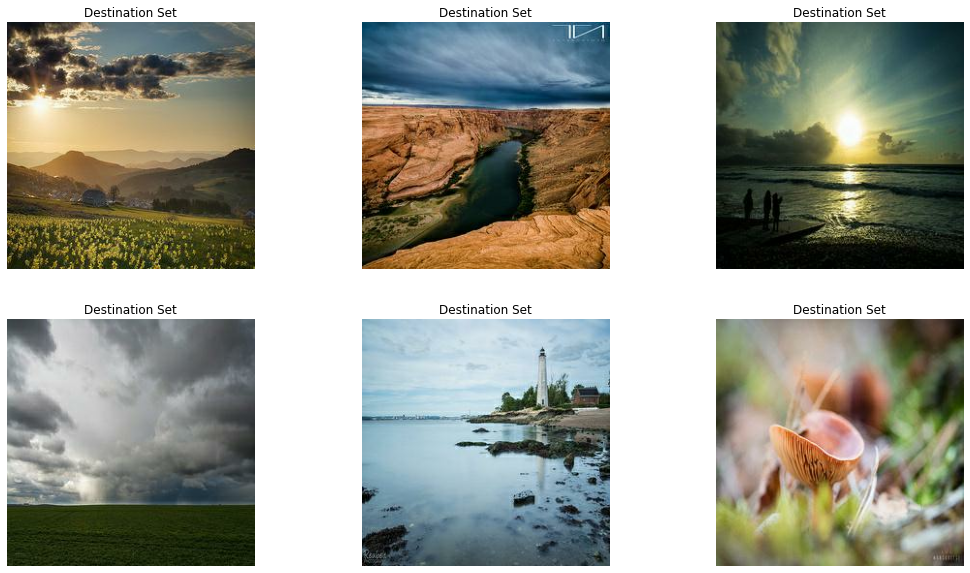

In [ ]:
fig, axis = plt.subplots(2, 3, figsize=(18, 10))
for i, ax in enumerate(axis.flat):
    ax.imshow(dest[i] * 0.5 + 0.5)
    ax.set(title = f"Destination Set")
    ax.axis('off')

## Build the model


### Build the generator


In [ ]:
def downsample(filters, size, stride, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    
    result = tf.keras.Sequential()
    result.add(
              tf.keras.layers.Conv2D(
                  filters, 
                  size, 
                  strides=stride, 
                  padding='same',
                  kernel_initializer=initializer, 
                  use_bias=False)
    )
    if apply_batchnorm:
        result.add(tfa.layers.InstanceNormalization())#tfa.layers.InstanceNormalization()

    result.add(tf.keras.layers.LeakyReLU(0.4))
    
    return result

In [ ]:
def upsample(filters, size, stride):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    layer = tf.keras.layers.Conv2DTranspose(
            filters, 
            size, 
            strides=stride,
            padding='same',
            kernel_initializer=initializer,
            use_bias=False)
    
    result.add(
        layer
    )
    return result

In [ ]:
def Generator():
    input_encoder = tf.keras.layers.Input(shape=[IMG_HEIGHT, IMG_WIDTH,3])
    input_generator = tf.keras.layers.Input(shape=[noise_dim, ])
    initializer = tf.random_normal_initializer(0., 0.02)

    down_stack = [
        #downsample(32, 3, 2, apply_batchnorm=False),
        downsample(64, 3, 2,False),
        downsample(128, 3, 2),
        downsample(256, 3, 2,False),
        downsample(512, 3, 2,),
        downsample(512, 3, 2,False),
        downsample(512, 3, 2,),
     ]
    x = input_encoder
    skips = []
    for down in down_stack:
        x = down(x)
        skips.append(x)

    skips = reversed(skips[:-1])
    gen_layer = tf.keras.layers.Dense(4*4*512)(input_generator)
    gen_layer = tf.keras.layers.BatchNormalization()(gen_layer)
    gen_layer = tf.keras.layers.LeakyReLU(0.4)(gen_layer)

    reshape = tf.keras.layers.Reshape((4, 4, 512))(gen_layer)
    x = reshape
    up_stack = [
              upsample(512, 3, 2, ),
              upsample(512, 3, 2, ),
              upsample(256, 3, 2, ),
              upsample(128, 3, 2, ),
              upsample(64, 3, 2, ), 
      
   ]

    last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 3,
                                      strides=2,
                                      padding='same',
                                      kernel_initializer=initializer,
                                      activation='tanh') 
    
    filters = [512,512,256,128,64]
    ndim = [8,16,32,64,128]
    for up, skip, dim, filt in zip(up_stack, skips, ndim, filters):
        x = up(x)
        n = noise_(dim, filt, input_generator)
        x = tf.keras.layers.concatenate([n, x])
        x = tf.keras.layers.BatchNormalization()(x)
        x = tf.keras.layers.LeakyReLU(0.4)(x)

        x = tf.keras.layers.concatenate([x, skip])
    
    x = last(x)
    return tf.keras.Model(inputs=[input_encoder,input_generator], outputs=x)

In [ ]:
generator = Generator()
generator.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 100)]        0           []                               
                                                                                                  
 dense (Dense)                  (None, 8192)         827392      ['input_2[0][0]']                
                                                                                                  
 batch_normalization (BatchNorm  (None, 8192)        32768       ['dense[0][0]']                  
 alization)                                                                                       
                                                                                                  
 leaky_re_lu_6 (LeakyReLU)      (None, 8192)         0           ['batch_normalization[0][0]']

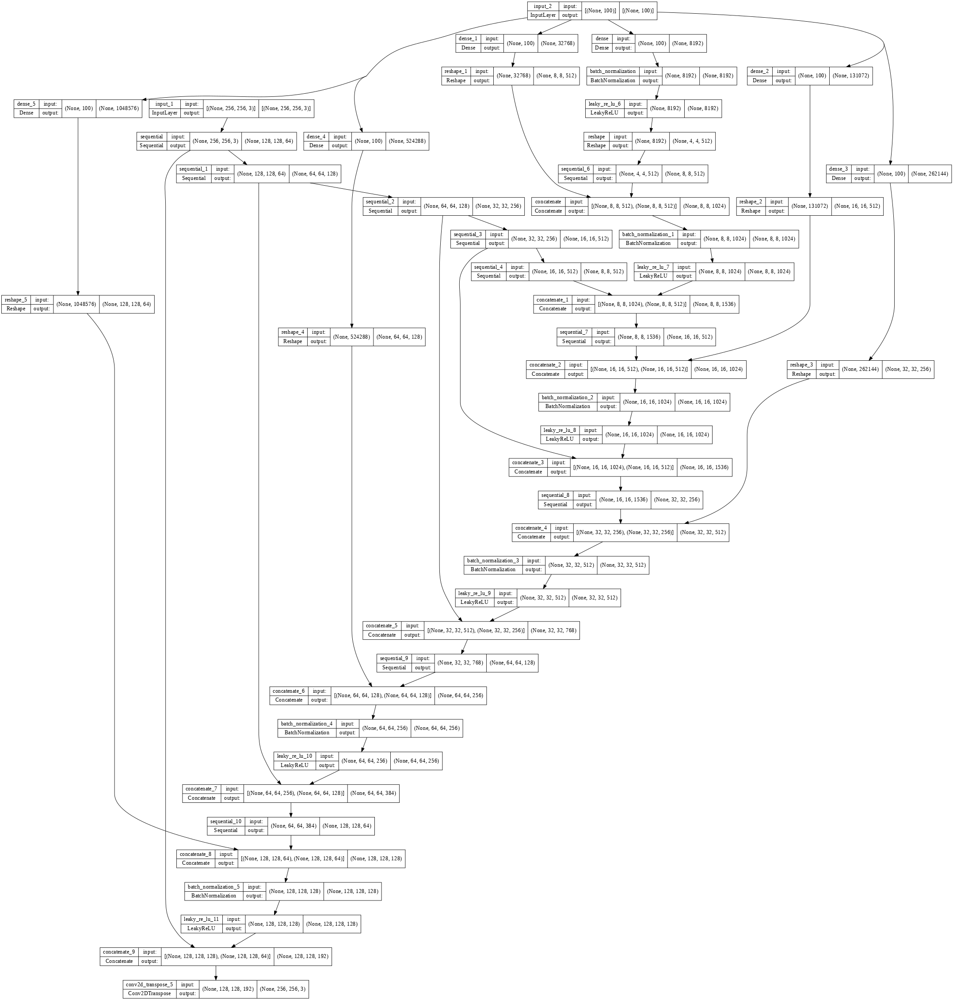

In [ ]:
plot_model(generator, show_shapes=True, dpi=64)

### Build Discriminator

In [ ]:
def Discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    input_ = tf.keras.layers.Input(shape=[IMG_HEIGHT, IMG_WIDTH, 3], name='input_image')
    down1 = downsample(64, 3, 2,False)(input_)
    down2 = downsample(128, 3, 2)(down1)

    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down2)
    conv = tf.keras.layers.Conv2D(256, 3, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)
    batchnorm1 = tf.keras.layers.BatchNormalization()(conv) #Itfa.layers.InstanceNormalization()

    leaky_relu = tf.keras.layers.LeakyReLU(0.4)(batchnorm1)

    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)
    
    last = tf.keras.layers.Conv2D(1, 3, strides=1,
                                kernel_initializer=initializer,
                                )(zero_pad2)
    return tf.keras.Model(inputs=input_, outputs=last)

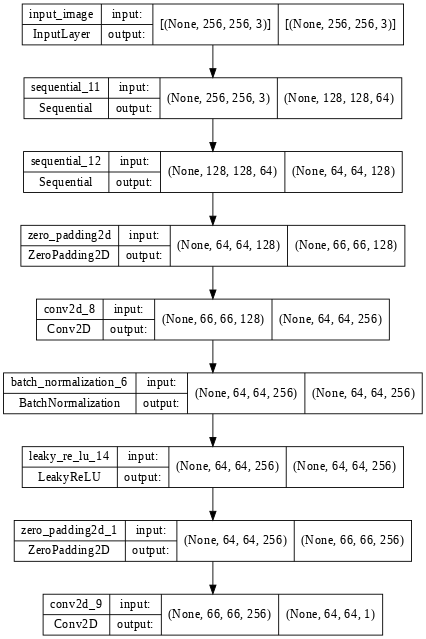

In [ ]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

### Define the Loss Function

In [ ]:
LAMBDA = 10
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [ ]:
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)

    generated_loss = loss_obj(tf.zeros_like(generated), generated)
    total_disc_loss = real_loss + (generated_loss)*LAMBDA*0.5
    loss_ = (generated_loss)*LAMBDA*0.5
    
    return total_disc_loss, loss_

In [ ]:
def generator_loss(disc_generated_output, gen_output, target):
    gan_loss = loss_obj(tf.ones_like(disc_generated_output), disc_generated_output)

    # mean absolute error
    l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
    total_gen_loss = gan_loss + (LAMBDA *(l1_loss)*0.5)

    return total_gen_loss, gan_loss, l1_loss

In [ ]:
generator_optimizer = tf.keras.optimizers.Adam(1e-5, beta_1=0.5, beta_2=0.99,epsilon=1e-08)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-5, beta_1=0.5, beta_2=0.99,epsilon=1e-08)

### Train the model and generate the fake painting

In [ ]:
def generate_images(model, input_1, input_2, noise):
    prediction = model([input_1, noise], training=True)
    plt.figure(figsize=(15,15))

    display_list = [input_1[0], input_2[0], prediction[0]]
    title = ['Source Image', 'Destination Image', 'Predicted Image']

    for i in range(3):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')
    plt.show()


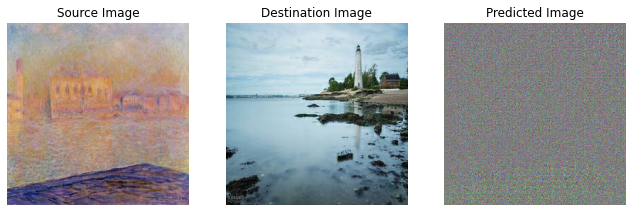

In [ ]:
example_input_1 = next(iter(train_source))
example_input_2 = next(iter(train_dest))
noise = tf.random.normal([BATCH_SIZE, noise_dim])
generate_images(generator, example_input_1, example_input_2,noise)

In [ ]:
def reconstruction(recon_x, x):
    return tf.reduce_mean(tf.abs(recon_x - x))

In [ ]:
@tf.function
def train_step(real_x, real_y, noise):
    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator([real_x,noise], training=True)

        real_output = discriminator(real_y, training=True)
        fake_output = discriminator(generated_images, training=True)
        gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(fake_output, generated_images, real_y)

        recon_loss = reconstruction(generated_images, real_x)
        disc_loss, _ = discriminator_loss(real_output, fake_output)
    gradients_of_generator = gen_tape.gradient(gen_total_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))  

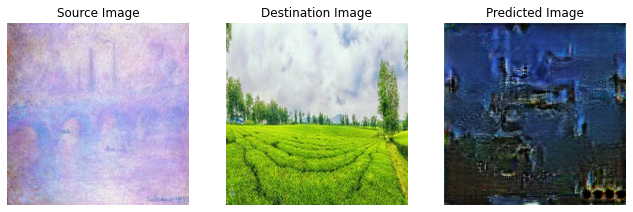

Time taken for epoch 2500 is 11.47561240196228 sec



In [ ]:
result=[]
for epoch in range(EPOCHS):
    start = time.time()

    n = 0
    for image_x, image_y in tf.data.Dataset.zip((train_source, train_dest)):
        noise = tf.random.normal([BATCH_SIZE, noise_dim])
        train_step(image_x, image_y, noise)
        if n % 20 == 0:
            print ('.', end='')
        n+=1

    clear_output(wait=True)
    generate_images(generator, image_x, image_y, noise)
    print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                      time.time()-start))
    if epoch>=2000:
        pred = generator([image_x, noise], training=True)
        result.append(pred[0])

## Generated Images

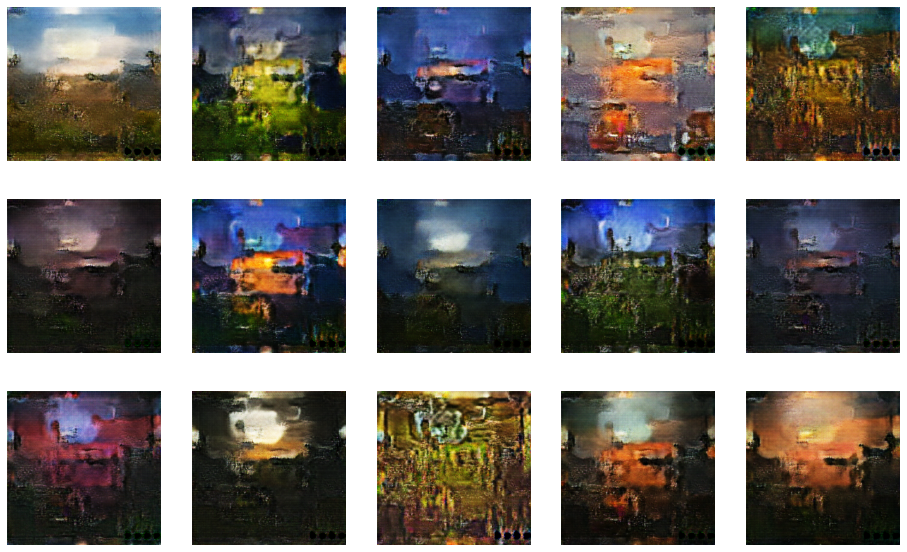

In [ ]:
res_1 = result[455:470]
fig, axis = plt.subplots(3, 5, figsize=(16, 10))
for i, ax in enumerate(axis.flat):
    ax.imshow(res_1[i] * 0.5 + 0.5)
    ax.axis('off')

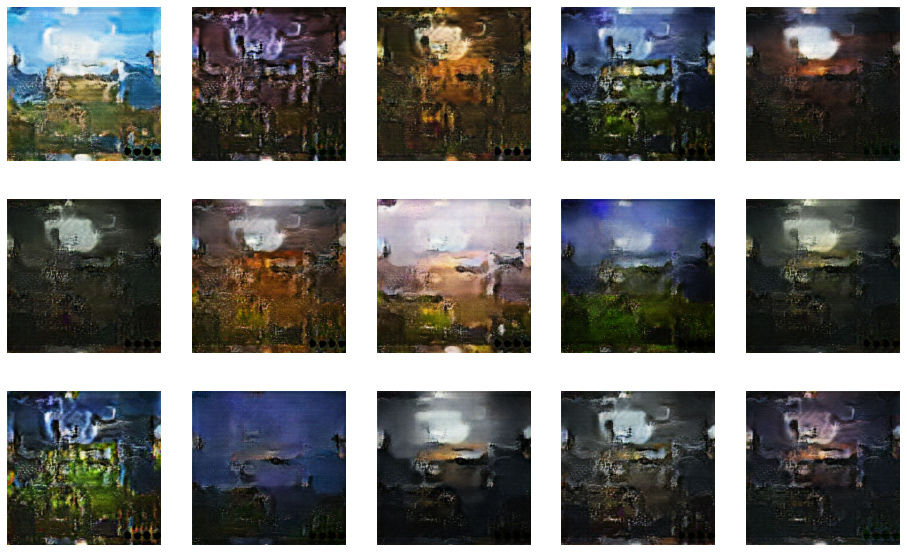

In [ ]:
res_3 = result[300:315]
fig, axis = plt.subplots(3, 5, figsize=(16, 10))
for i, ax in enumerate(axis.flat):
    ax.imshow(res_3[i] * 0.5 + 0.5)
    ax.axis('off')

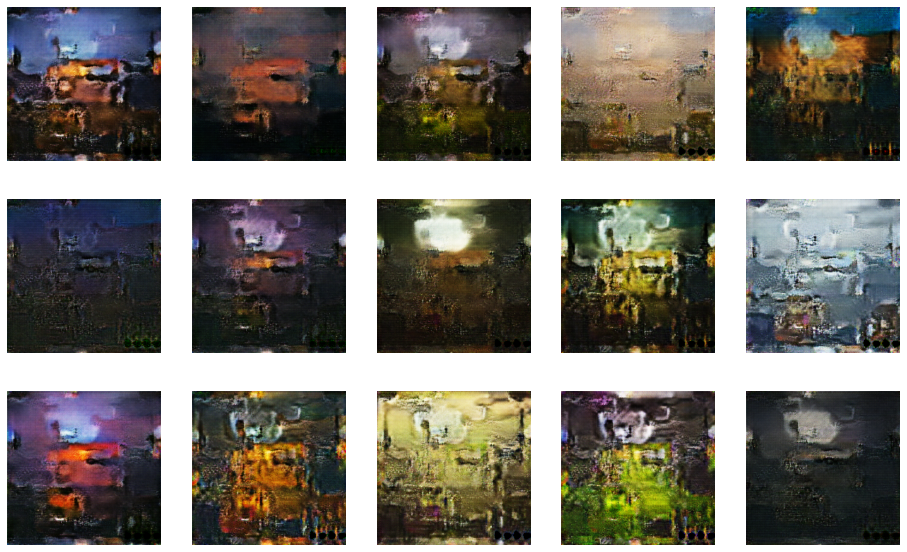

In [ ]:
res_5 = result[100:115]
fig, axis = plt.subplots(3, 5, figsize=(16, 10))
for i, ax in enumerate(axis.flat):
    ax.imshow(res_5[i] * 0.5 + 0.5)
    ax.axis('off')

# Conclusion

Among three methods, the `CycleGAN` gives us a best results while `Neural Style Transfer` gives us a much faster way to do it. `StyleALAE` is a new way to complete the task, but it didn't work as well as other two models did.